## Automatic Music Summarization via Similarity Analysis

### By: Zakaria El Founoun

The goal of this notebook is to reproduce the numerical experiments from the paper `Automatic Music Summarization via Similarity Analysis` By `Matthew Cooper and Jonathan Foote`

In [52]:
# Importing dependencies 
import librosa
import numpy as np
from sklearn.preprocessing import scale
from sklearn.metrics.pairwise import cosine_distances
from IPython.display import Audio, display
from scipy.spatial.distance import pdist, squareform
import matplotlib.pyplot as plt
import pandas as pd 
from tqdm import tqdm
import warnings
warnings.filterwarnings('ignore')

# The first experiment:

In this experiment, the goal is to generate a synthetic three-tone test signal by concatenating 30 seconds of a 1 kHz
sine wave, 40 seconds of 500 Hz, and 30 seconds of 2 kHz to result in a one-hundred second signal. Because the 500 Hz portion is the
longest, the ideal summary should consist primarily of the 500 Hz
signal as opposed to the shorter 1 KHz and 2 KHz segments.

In [62]:
# Let's first define a function that will display  part of the audio defined by a sart and end time
def display_(audio, fs, start, end):
    """
    start and end should be in seconds
    """
    start =int(fs * start)
    end = int(fs * end)
    return display(Audio(audio[start: end +1 ], rate=fs))

In [46]:
import numpy as np
from IPython.display import Audio, display

# Define sampling rate and duration of each tone
fs = 6000  # Hz ## this value is choosed for 2 reasons: Audio CDs and most digital audio formats use a sampling rate of 44.1 kHz, so this is a commonly used sampling rate in audio processing. + obvisusly to respect the Nyquist-Shannon sampling theorem
dur1 = 30   # seconds
dur2 = 40   # seconds
dur3 = 30   # seconds

# Generate tone signals
t1 = np.arange(0, dur1, 1/fs)
t2 = np.arange(dur1, dur1+dur2, 1/fs)
t3 = np.arange(dur1+dur2, dur1+dur2+dur3, 1/fs)

f1 = 1000   # Hz
f2 = 500    # Hz
f3 = 2000   # Hz

y1 = np.sin(2*np.pi*f1*t1)
y2 = np.sin(2*np.pi*f2*t2)
y3 = np.sin(2*np.pi*f3*t3)

# Concatenate tone signals
y_synth = np.concatenate((y1, y2, y3))

# Let's display sound
display(Audio(y_synth, rate=fs))


Next step is to define the utilities functions, that will be used in this project

In [5]:
def similarity_matrix(matrix, distance = cosine_distances):
    """ 
    This functions aims at computing the similarity matrix from the rows of the matrix based on the provised distance function 
    """
    D = pdist(matrix, metric='cosine')
    # Convert to square distance matrix
    D_square = 1 - squareform(D)
    return D_square

def parametrize_audio(audio, fs, mono = False):
    """
    A function to parametrize the audio and return the corresponding representative matrix as described in the original paper 
    For this purpose we are going to implement this parametrization with the aid of the librosa library
    """
    
    sr_new = 22050  # sampling rate
    if fs != sr_new:
        # Let's resample the audio 
        audio_resampled  = librosa.resample(audio, orig_sr=fs, target_sr=sr_new)
    else:
        audio_resampled = audio
    if not mono:
        audio_mono = librosa.to_mono(audio_resampled)
    else:
        audio_mono = audio_resampled
    

    # Compute the MFCC coefficients for each frame
    hop_length = int(sr_new / 10)   # windowing at 10hz rate 
    n_mfcc = 45
    mfcc = librosa.feature.mfcc(y=audio_mono, sr= sr_new, S=None, n_mfcc=n_mfcc, hop_length=hop_length, window='hamming') # the shape now is (45, *)

    # Order the MFCCs by variance and retain the top 15
    variances = np.var(mfcc, axis=1)
    mfcc_indices = np.argsort(variances)[::-1][:15]
    mfcc_top15 = mfcc[mfcc_indices, :]
    
    # Scale the coefficients to unit variance across the piece
    mfcc_scaled = scale(mfcc_top15, axis=1).T
    similarity = similarity_matrix(mfcc_scaled)
    
    return audio_mono,similarity

def summarize(audio,fs, L, mono = False):
    """ 
    A function to summarize the giving audio in a L length contiguous frames
    L is in seconds
    """
    _,similarity = parametrize_audio(audio, fs, mono)
    #time_axis = np.linspace(0, len(audio) // fs, len(similarity))
    def score(q, r):
        """
        A function to compute the similarity score of a segment starting at frame q and ending at frame r
        """
        return sum(sum(similarity[i]) for i in range(q,r+1))
    # Now let's find the best starting time 
    # To do so, we start by constructing the scores matrix that computes the scores for each segment of length L 
    L *= 10 # we used a windowing rate of 10 Hz 
    scores = [score(i, i+L) for i in range(len(similarity) - L)]
    #return scores
    best_starting_frame = np.argmax(scores)
    best_starting_time =  best_starting_frame / 10 # the corresponding starting index in the audio array
    return {'Segment length (s)': L//10 ,'best_starting_time (s)': best_starting_time}

 Now that we have defined all the utilities let's run the experiments as proposed in the paper 

In [112]:
# Let's continue with the first experiment:
recap_exp1 = pd.DataFrame([summarize(y_synth, fs, 20), summarize(y_synth, fs, 30), summarize(y_synth, fs, 40)])
recap_exp1

,Segment length (s),best_starting_time (s)
0,200,30.1
1,300,30.1
2,400,30.0


* **Conclusion :** we can see that the best starting time is always 30s, which is the expected behaviour, since the most important tone is the second tone starting at 30s and last for 40s.

## The second experiment

In this experiment, we are going to do the same analysis for `the magical mystery tour`

In [53]:
# reading data 
audio_file_path = "Magical_Mystery_Tour.wav"
y_magical_mystery_tour, sr = librosa.load(audio_file_path, sr = 22050, mono= True)

In [54]:
display(Audio(y_magical_mystery_tour, rate=22050))

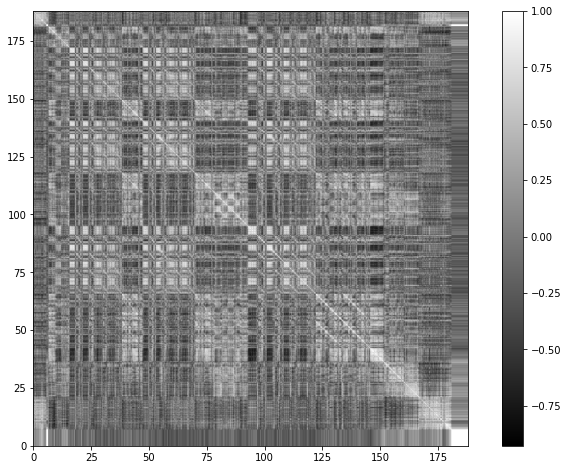

In [139]:
# Let's show the similarity matrix 
fs = 22050
simm = parametrize_audio(y_magical_mystery_tour, fs, mono = True)[1]

fig, ax  = plt.subplots(figsize= (12,8))
im = ax.imshow(simm, cmap = 'gray', extent= [0,188 ,0, 188])
fig.colorbar(im, ax = ax)
fig.show()

In [130]:
recap_exp2 = pd.DataFrame([summarize(y_magical_mystery_tour, fs, 10, mono = True), summarize(y_magical_mystery_tour, fs, 20, mono = True), summarize(y_magical_mystery_tour, fs, 30, mono = True)])
recap_exp2

c:\Users\zakar\anaconda3\envs\deep_learning_iot\lib\site-packages\sklearn\preprocessing\_data.py:236: UserWarning: Numerical issues were encountered when centering the data and might not be solved. Dataset may contain too large values. You may need to prescale your features.
  "Numerical issues were encountered "
c:\Users\zakar\anaconda3\envs\deep_learning_iot\lib\site-packages\sklearn\preprocessing\_data.py:255: UserWarning: Numerical issues were encountered when scaling the data and might not be solved. The standard deviation of the data is probably very close to 0. 
  "Numerical issues were encountered "
c:\Users\zakar\anaconda3\envs\deep_learning_iot\lib\site-packages\sklearn\preprocessing\_data.py:236: UserWarning: Numerical issues were encountered when centering the data and might not be solved. Dataset may contain too large values. You may need to prescale your features.
  "Numerical issues were encountered "
c:\Users\zakar\anaconda3\envs\deep_learning_iot\lib\site-packages\skle

,Segment length (s),best_starting_time (s)
0,100,82.9
1,200,72.8
2,300,117.0


## The Third experiment

In this experiment, we are going to do the same analysis for `Antonio-Vivaldi-The-Four-Seasons-Spring-Allegro`

In [8]:
# reading data 
audio_file_path = "Antonio-Vivaldi-The-Four-Seasons-Spring-Allegro.wav"
y_vivaldi, sr = librosa.load(audio_file_path, sr = 22050, mono= True)

display(Audio(y_vivaldi, rate=22050))

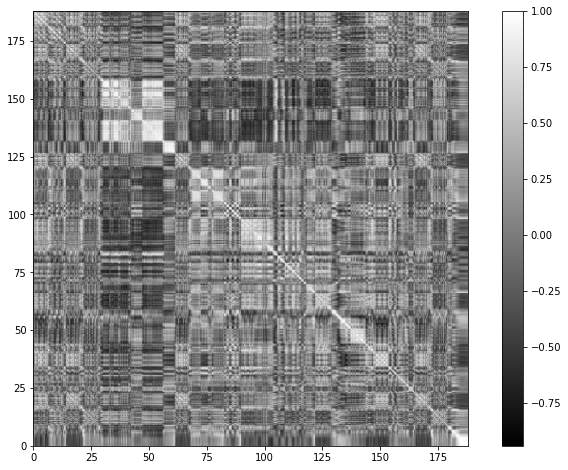

In [142]:
# Let's show the similarity matrix 
fs = 22050
simm = parametrize_audio(y_vivaldi, fs, mono = True)[1]

fig, ax  = plt.subplots(figsize= (12,8))
im = ax.imshow(simm, cmap = 'gray', extent= [0,188 ,0, 188])
fig.colorbar(im, ax = ax)
fig.show()

In [143]:
recap_exp3 = pd.DataFrame([summarize(y_vivaldi, fs, 10, mono = True), summarize(y_vivaldi, fs, 20, mono = True), summarize(y_vivaldi, fs, 30, mono = True)])
recap_exp3

,Segment length (s),best_starting_time (s)
0,10,97.2
1,20,87.6
2,30,77.7


## The 4th experiment

In this experiment, we are going to do the same analysis for `U2-Wild-Honey-_Official-Unofficial_-Music-Video.wav`

In [66]:
# reading data 
audio_file_path = "U2-Wild-Honey-_Official-Unofficial_-Music-Video.wav"
y_wild_honey, sr = librosa.load(audio_file_path, sr = 22050, mono= True)

display(Audio(y_wild_honey, rate=22050))

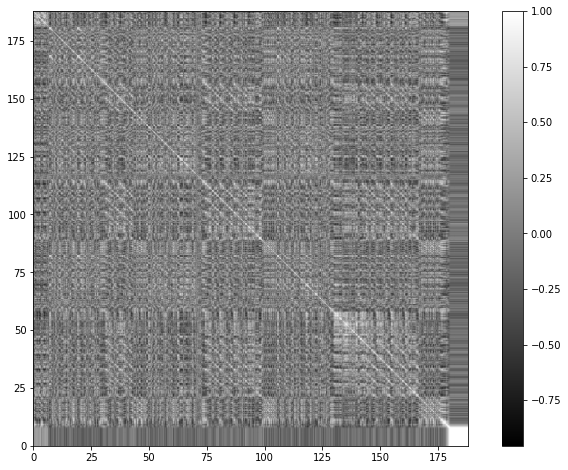

In [145]:
# Let's show the similarity matrix 
fs = 22050
simm = parametrize_audio(y_wild_honey, fs, mono = True)[1]

fig, ax  = plt.subplots(figsize= (12,8))
im = ax.imshow(simm, cmap = 'gray', extent= [0,188 ,0, 188])
fig.colorbar(im, ax = ax)
fig.show()

In [146]:
recap_exp4 = pd.DataFrame([summarize(y_wild_honey, fs, 10, mono = True), summarize(y_wild_honey, fs, 20, mono = True), summarize(y_wild_honey, fs, 30, mono = True)])
recap_exp4

,Segment length (s),best_starting_time (s)
0,10,140.0
1,20,130.5
2,30,144.5


# As a bonus: try to automaticaly adjust for the length L

In [14]:
# Now in this section we are interessted in automating the selection of the length L of the representative segment 

def summarize2(audio,fs, mono = False):
    """ 
    A new version of the previous summarize function with automatically choosing the best length L 
    Because of the computational resources limitation, the range of research for L will be from 10 seconds (a summary should be large enough), and less than the half of the duration of the audio
    """
    _,similarity = parametrize_audio(audio, fs, mono)
    #time_axis = np.linspace(0, len(audio) // fs, len(similarity))
    def score(q, r):
        """
        A function to compute the similarity score of a segment starting at frame q and ending at frame r, normalized by the segment length 
        """
        return (1/(r-q)) * sum(sum(similarity[i]) for i in range(q,r+1))
    # Now let's find the best starting time 
    # To do so, we start by constructing the scores matrix that computes the scores for each segment of length L 
    
    res = {'Segment length (s)' : [],'best_starting_time (s)' : [], 'best score': [] } # a dict to hold the best score found for a giving length L 
    for L in tqdm(range(100, len(similarity) // 2, 50)): # L is in ms , step is 5 seconds
        scores = [score(i, i+L) for i in range(len(similarity) - L)]
        #return scores
        best_starting_frame = np.argmax(scores)
        best_starting_time =  best_starting_frame / 10 # the corresponding starting index in the audio array
        res['Segment length (s)'].append(L//10)
        res['best_starting_time (s)'].append(best_starting_time)
        res['best score'].append(scores[best_starting_frame])
    best_length_index = np.argmax(res['best score'])
    print(f"best starting time {res['best_starting_time (s)'][best_length_index]} and the best duration is {res['Segment length (s)'][best_length_index]}")
    return pd.DataFrame(res)

### Now let's apply this method for all the audios 

In [15]:
# The first exeperiment 
summarize2(y_synth, fs = 6000)

100%|██████████| 8/8 [02:24<00:00, 18.10s/it]


best starting time 30.1 and the best duration is 10


,Segment length (s),best_starting_time (s),best score
0,10,30.1,66.697886
1,15,30.1,66.477761
2,20,30.1,66.367698
3,25,30.1,66.301661
4,30,30.1,66.257636
5,35,30.1,66.226189
6,40,30.0,66.004818
7,45,25.0,56.221670


c:\Users\zakar\anaconda3\envs\deep_learning_iot\lib\site-packages\ipykernel_launcher.py:21: UserWarning: Matplotlib is currently using module://matplotlib_inline.backend_inline, which is a non-GUI backend, so cannot show the figure.


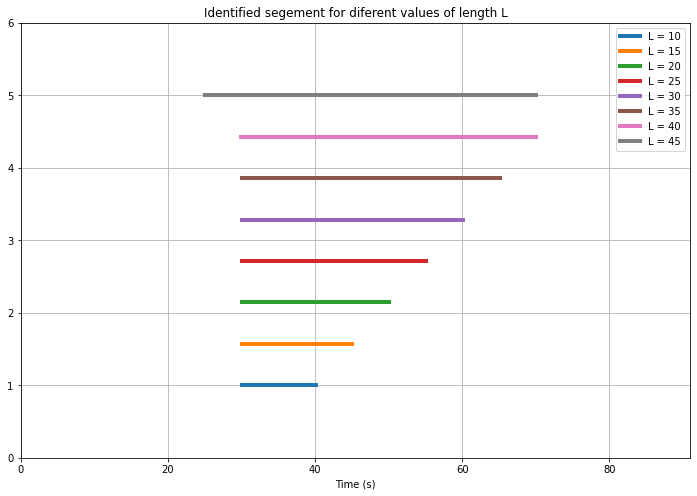

In [30]:
# let's rearange the data to have visualization recap 
starting_times = np.array([30.1, 30.1, 30.1, 30.1, 30.1, 30.1, 30.0, 25.0]) 
segment_lengths = np.arange(10,50, 5)
stoping_time = starting_times + segment_lengths
fig, ax = plt.subplots(figsize = (12,8))
hpositions = np.linspace(1, 5, len(segment_lengths))

# Create a colormap
cmap = plt.cm.get_cmap('tab10')

max_ = 1.3 * max(stoping_time)
for i in range(len(starting_times)):
    ax.axhline(hpositions[i], xmin = starting_times[i] /max_ , xmax = stoping_time[i] / max_, label = f'L = {segment_lengths[i]}', color = cmap(i), linewidth=4)

ax.set_xlim([0, max_])
ax.set_ylim([0, 6])
ax.set_xlabel('Time (s)')
ax.set_title('Identified segement for diferent values of length L')
plt.legend()
plt.grid(True)
fig.show()

In [17]:
# The second experiment 
summarize2(y_magical_mystery_tour, fs = 22050,mono= True)

100%|██████████| 17/17 [29:49<00:00, 105.26s/it]

best starting time 82.9 and the best duration is 10


,Segment length (s),best_starting_time (s),best score
0,10,82.9,45.643089
1,15,77.8,44.904443
2,20,72.8,43.306393
3,25,68.1,40.849449
4,30,117.0,37.795821
5,35,110.9,37.666409
6,40,110.7,37.180602
7,45,106.0,36.207544
8,50,107.7,35.802297
9,55,104.4,35.111956


c:\Users\zakar\anaconda3\envs\deep_learning_iot\lib\site-packages\ipykernel_launcher.py:25: UserWarning: Matplotlib is currently using module://matplotlib_inline.backend_inline, which is a non-GUI backend, so cannot show the figure.


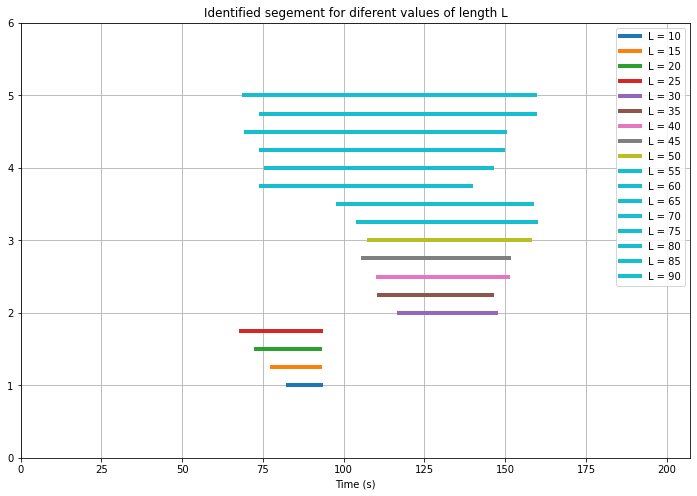

In [34]:
# let's rearange the data to have visualization recap 
starting_times = np.array([ 82.9,  77.8,  72.8,  68.1, 117. , 110.9, 110.7, 106. , 107.7,
       104.4,  98.2,  74.3,  75.9,  74.3,  69.8,  74.3,  69.1]) 

segment_lengths = np.arange(10,95, 5)

stoping_time = starting_times + segment_lengths

fig, ax = plt.subplots(figsize = (12,8))
hpositions = np.linspace(1, 5, len(segment_lengths))

# Create a colormap
cmap = plt.cm.get_cmap('tab10')

max_ = 1.3 * max(stoping_time)
for i in range(len(starting_times)):
    ax.axhline(hpositions[i], xmin = starting_times[i] /max_ , xmax = stoping_time[i] / max_, label = f'L = {segment_lengths[i]}', color = cmap(i), linewidth=4)

ax.set_xlim([0, max_])
ax.set_ylim([0, 6])
ax.set_xlabel('Time (s)')
ax.set_title('Identified segement for diferent values of length L')
plt.legend()
plt.grid(True)
fig.show()

In [18]:
# The second experiment 
summarize2(y_wild_honey, fs = 22050,mono= True)

100%|██████████| 22/22 [1:14:05<00:00, 202.07s/it]


best starting time 140.0 and the best duration is 10


,Segment length (s),best_starting_time (s),best score
0,10,140.0,25.989416
1,15,134.8,22.094339
2,20,130.5,22.314454
3,25,125.8,21.339370
4,30,144.5,19.876572
5,35,139.7,20.141400
6,40,131.4,19.723376
7,45,130.4,19.598589
8,50,124.5,19.497831
9,55,125.0,19.150755


c:\Users\zakar\anaconda3\envs\deep_learning_iot\lib\site-packages\ipykernel_launcher.py:26: UserWarning: Matplotlib is currently using module://matplotlib_inline.backend_inline, which is a non-GUI backend, so cannot show the figure.


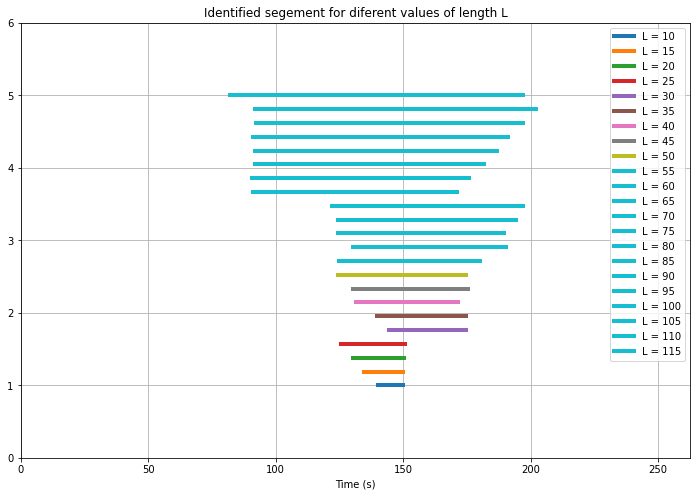

In [39]:

# let's rearange the data to have visualization recap 
starting_times = np.array([140. , 134.8, 130.5, 125.8, 144.5, 139.7, 131.4, 130.4, 124.5,
       125. , 130.4, 124.6, 124.4, 122.2,  91.2,  90.7,  91.9,  92, 91.1,
        92.2,  92. ,  82.2])

segment_lengths = np.arange(10,120, 5)

stoping_time = starting_times + segment_lengths

fig, ax = plt.subplots(figsize = (12,8))
hpositions = np.linspace(1, 5, len(segment_lengths))

# Create a colormap
cmap = plt.cm.get_cmap('tab10')

max_ = 1.3 * max(stoping_time)
for i in range(len(starting_times)):
    ax.axhline(hpositions[i], xmin = starting_times[i] /max_ , xmax = stoping_time[i] / max_, label = f'L = {segment_lengths[i]}', color = cmap(i), linewidth=4)

ax.set_xlim([0, max_])
ax.set_ylim([0, 6])
ax.set_xlabel('Time (s)')
ax.set_title('Identified segement for diferent values of length L')
plt.legend()
plt.grid(True)
fig.show()

* **Conclusion :** In all the givging exepriences, the implemented method outputs a tone that is the most repetitive in the signal. The fact that while increasing the segment length we have an  overlaping segments prooves the stability of the model.